# Анализ и прогнозирование временных рядов методами искусственного интеллекта

## **Практическая работа 1. Метрики и меры схожести между временными рядами.**

Смените рабочую директорию с помощью команды `chdir()`. Для этого передайте этой команде свой путь до каталога, в котором содержатся материалы первой практической работы. После выполнения этой команды все последующие операции с файлами и каталогами будут производиться относительно указанного каталога.

In [1]:
import os

practice_dir_path = '/Users/davidlimcher/Desktop/Python/TimeSeriesCourse/practice/01 Basics'
os.chdir(practice_dir_path)

Выполните команды, которые автоматически перезагружают все импортированные модули при их изменении.

In [2]:
#%load_ext autoreload
#%autoreload 2

Импортируйте библиотеки и модули, необходимые для реализации практической работы 1.

In [3]:
#!pip install sktime

In [4]:
import numpy as np
import random
from sktime.distances import euclidean_distance, dtw_distance, pairwise_distance
from sklearn.metrics import silhouette_score
import cv2
import imutils
import glob
import matplotlib.pyplot as plt


from modules.metrics import ED_distance, norm_ED_distance, DTW_distance
from modules.pairwise_distance import PairwiseDistance
from modules.clustering import TimeSeriesHierarchicalClustering
from modules.classification import TimeSeriesKNN, calculate_accuracy
from modules.image_converter import Image2TimeSeries
from modules.utils import read_ts, z_normalize, sliding_window, random_walk
from modules.plots import plot_ts

## **Часть 1.** Функции расстояния: евклидова метрика и DTW мера. Матрица расстояний. Иерархическая кластеризация временных рядов.

### **Задача 1.**
Реализуйте самостоятельно функцию `ED_distance()` в модуле *metrics.py*, которая вычисляет евклидово расстояние между двумя временными рядами, имеющими одинаковую длину. В качестве входных данных передайте в функцию два синтетических временных ряда некоторой заданной вами длины. Для их генерации используйте функцию `random_walk()` из модуля *utils.py*,  реализующую модель случайных блужданий (Random Walk), или стандартный модуль *random*.

**Евклидово расстояние** между двумя временными рядами $T_1$ и $T_2$ длины $n$ вычисляется следующим образом:

\begin{equation}
    \text{ED}(T_1, T_2) = \sqrt{\sum_{i=1}^{n} ({t_{1}}_i-{t_{2}}_i)^2}.
\end{equation}

Проверьте реализацию функции, сравнив свои результаты с результатами функции [`euclidean_distance()`](https://www.sktime.net/en/latest/api_reference/auto_generated/sktime.distances.euclidean_distance.html) из библиотеки *sktime*, с помощью `test_distances()`.

In [5]:
def test_distances(dist1: float, dist2: float) -> None:
    """
    Check whether your distance function is implemented correctly

    Parameters
    ----------
    dist1 : distance between two time series calculated by sktime
    dist2 : distance between two time series calculated by your function
    """

    np.testing.assert_equal(round(dist1, 5), round(dist2, 5), 'Distances are not equal')

In [6]:
# Генерация двух временных рядов с помощью random_walk()
ts1 = random_walk(100)  # Например, 100 точек
ts2 = random_walk(100)


In [7]:
from sktime.distances import euclidean_distance

# Рассчитаем евклидово расстояние с помощью вашей функции
dist_my_func = ED_distance(ts1, ts2)

# Рассчитаем евклидово расстояние с помощью sktime для сравнения
dist_sktime = euclidean_distance(ts1, ts2)

# Проверим корректность
test_distances(dist_sktime, dist_my_func)

# Вывод для проверки
print("Результат моей функции:", dist_my_func)
print("Результат sktime функции:", dist_sktime)


Результат моей функции: 110.67068265805538
Результат sktime функции: 110.67068265805538


### **Задача 2.**

Реализуйте самостоятельно функцию `DTW_distance()` в модуле *metrics.py*, которая вычисляет DTW расстояние между двумя временными рядами, имеющими одинаковую длину. Для вычисления расстояния между элементами временных рядов в DTW мере используйте евклидово расстояние. Временные ряды сгенерируйте аналогичным образом, как в задаче 1, или используйте уже созданные.

**Динамическая трансформация временной шкалы (Dynamic Time Warping, DTW)** – мера схожести между двумя временными рядами $T_1$ и $T_2$ длины $n$, вычисляемая следующим образом:

\begin{equation}
\text{DTW}(T_1, T_2) = d(n,n),
\\ d(i,j) = ({t_{1}}_i - {t_{2}}_j)^2 + \min \left\{
	\begin{array}{l l}
	d(i-1,j), \\
	d(i,j-1), \\
	d(i-1,j-1),
	\end{array}
	\right.
\\ d(0,0)=0, \quad d(i,0)=d(0,j)=\infty, \quad  1 \leqslant i,j \leqslant n.
\end{equation}

Сравните свои результаты с результатами функции [`dtw_distance()`](https://www.sktime.net/en/latest/api_reference/auto_generated/sktime.distances.dtw_distance.html) из библиотеки *sktime*. Для этого используйте `test_distances()` из задачи 1.

In [8]:
from sktime.distances import dtw_distance

def test_distances(T1, T2):
    # Преобразование списков в numpy массивы
    T1 = np.array(T1)
    T2 = np.array(T2)
    
    # Сравнение с библиотечной реализацией
    my_result = DTW_distance(T1, T2)
    sktime_result = dtw_distance(T1, T2)
    
    print(f"My DTW distance: {my_result}")
    print(f"sktime DTW distance: {sktime_result}")
    assert np.isclose(my_result, sktime_result), "Результаты не совпадают!"

# Пример теста
if __name__ == "__main__":
    test_distances(ts1, ts2)


My DTW distance: 5986.0
sktime DTW distance: 5986.0


### **Задача 3.**
Реализуйте нахождение матрицы расстояний между несколькими временными рядами.
Для этого заполните все методы c недостающим кодом в классе `PairwiseDistance` из модуля *pairwise_distance.py*. Для вычисления расстояний между рядами используйте ранее реализованные вами функции `ED_distance()` и `DTW_distance()` из модуля *metrics.py*.

Матрица расстояний между временными рядами определяется следующим образом. Пусть дано множество $S$, состоящее из $K$ временных рядов длины $n$: $\;S = \{T_1, T_2, ..., T_K\}, \; T_i \in \mathbb{R}^n$. Тогда под **матрицей расстояний** $D \in \mathbb{R}^{K \times K}$ понимается квадратная матрица, где каждый ее элемент $d(i,j)$ представляет собой расстояние между временными рядами $T_i$ и $T_j$ из множества $S$:
\begin{equation}
d(i,j) = dist(T_i, T_j), \quad T_i, T_j \in S, \quad 1 \leqslant i,j \leqslant K.
\end{equation}

Поскольку евклидова метрика и DTW мера удовлетворяют аксиоме симметричности (т.е. $dist(T_i, T_j)=dist(T_j, T_i)$), то матрица расстояний $D$ будет симметричной относительно главной диагонали. Для ускорения вычислений достаточно найти ее верхний треугольник, а нижний треугольник матрицы заполнить значениями верхнего треугольника следующим образом:
\begin{equation}
d(j,i) = d(i,j), \; где \; i < j.
\end{equation}

<center><img src="https://github.com/mzym/TimeSeriesCourse/blob/main/practice/01%20Basics/img/distance_matrix.png?raw=true" width="600"></center>

Сгенерируйте множество, состоящее из $K$ временных рядов некоторой длины $n$. Вычислите матрицы евклидовых и DTW расстояний между ними. Проверьте реализованные вами методы, сравнив свои результаты с результатами функции [`pairwise_distance()`](https://www.sktime.net/en/latest/api_reference/auto_generated/sktime.distances.pairwise_distance.html) из библиотеки *sktime*.

In [9]:
def test_matrices(matrix1 : np.ndarray, matrix2 : np.ndarray) -> None:
    """
    Check whether your matrix function is implemented correctly

    Parameters
    ----------
    matrix1 : distance matrix calculated by sktime
    matrix2 : distance matrix calculated by your function
    """

    np.testing.assert_equal(matrix1.round(5), matrix2.round(5), 'Matrices are not equal')

In [10]:
from sktime.distances import pairwise_distance
import numpy as np

# Генерация множества временных рядов
time_series_set = np.array([random_walk(100) for _ in range(5)])

# Расчет матрицы расстояний с помощью вашего класса
pairwise_distance_instance = PairwiseDistance(metric='euclidean', is_normalize=False)
my_matrix = pairwise_distance_instance.calculate(time_series_set)

# Расчет матрицы расстояний с помощью sktime
sktime_matrix = pairwise_distance(time_series_set, metric="euclidean")

# Проверка корректности
test_matrices(sktime_matrix, my_matrix)


### **Задача 4.**
Далее рассмотрим задачу иерархической кластеризации временных рядов, где будет использоваться предвычисленная матрица расстояний.

Для этого сначала загрузите набор временных рядов CBF из файла *CBF_TRAIN.txt*, который располагается в директории *./datasets/part1*. Каждая строка данного файла содержит целевую переменную (класс: 0, 1 или 2) в первом столбце и временной ряд в остальных столбцах. Набор CBF является синтетическим и включает в себя 30 временных рядов,  каждый из которых принадлежит к одному из трех классов.

In [11]:
url = './datasets/part1/CBF_TRAIN.txt'

data = read_ts(url)

ts_set = data.iloc[:, 1:]
labels = data.iloc[:, 0]

/Users/davidlimcher/Desktop/Python/TimeSeriesCourse/practice/01 Basics/modules/utils.py:22: FutureWarning:

The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead



Выполните визуализацию по одному временному ряду из каждого класса. Для этого используйте функцию `plot_ts()` из модуля *plots.py*.

In [12]:
# Уникальные классы
unique_classes = labels.unique()

# Визуализация временных рядов
for class_label in unique_classes:
    # Берем первый временной ряд для текущего класса
    class_ts = ts_set[labels == class_label].iloc[0]  # Используем iloc для правильной индексации
    
    # Преобразуем временной ряд в двумерный массив
    class_ts_reshaped = class_ts.values.reshape(1, -1)  # Превращаем в двумерный массив
    
    # Визуализируем временной ряд с использованием функции plot_ts()
    plot_ts(class_ts_reshaped, plot_title=f'Class {class_label}')

### **Задача 2.**

Реализуйте самостоятельно функцию `DTW_distance()` в модуле *metrics.py*, которая вычисляет DTW расстояние между двумя временными рядами, имеющими одинаковую длину. Для вычисления расстояния между элементами временных рядов в DTW мере используйте евклидово расстояние. Временные ряды сгенерируйте аналогичным образом, как в задаче 1, или используйте уже созданные.

**Динамическая трансформация временной шкалы (Dynamic Time Warping, DTW)** – мера схожести между двумя временными рядами $T_1$ и $T_2$ длины $n$, вычисляемая следующим образом:

\begin{equation}
\text{DTW}(T_1, T_2) = d(n,n),
\\ d(i,j) = ({t_{1}}_i - {t_{2}}_j)^2 + \min \left\{
	\begin{array}{l l}
	d(i-1,j), \\
	d(i,j-1), \\
	d(i-1,j-1),
	\end{array}
	\right.
\\ d(0,0)=0, \quad d(i,0)=d(0,j)=\infty, \quad  1 \leqslant i,j \leqslant n.
\end{equation}

Сравните свои результаты с результатами функции [`dtw_distance()`](https://www.sktime.net/en/latest/api_reference/auto_generated/sktime.distances.dtw_distance.html) из библиотеки *sktime*. Для этого используйте `test_distances()` из задачи 1.

In [13]:
from sktime.distances import dtw_distance

def test_distances(T1, T2):
    # Преобразование списков в numpy массивы
    T1 = np.array(T1)
    T2 = np.array(T2)
    
    # Сравнение с библиотечной реализацией
    my_result = DTW_distance(T1, T2)
    sktime_result = dtw_distance(T1, T2)
    
    print(f"My DTW distance: {my_result}")
    print(f"sktime DTW distance: {sktime_result}")
    assert np.isclose(my_result, sktime_result), "Результаты не совпадают!"

# Пример теста
if __name__ == "__main__":
    test_distances(ts1, ts2)


My DTW distance: 5986.0
sktime DTW distance: 5986.0


Далее самостоятельно реализуйте класс `TimeSeriesHierarchicalClustering` из модуля *clustering.py*, который выполняет иерархическую кластеризацию временных рядов.

Перед тем как приступить к реализации, изучите скелет этого класса. Реализуйте метод `fit()`, выполняющий кластеризацию данных на основе предвычисленной матрицы расстояний, которая передается в данный метод. Поскольку реализовать иерархическую кластеризацию довольно сложно, используйте готовую реализацию [`AgglomerativeClustering`](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html) из *sklearn*.   

Выполните иерархическую кластеризацию загруженных временных рядов CBF для двух функций расстояния: евлидовой метрики и DTW меры.
Для этого сначала найдите матрицы расстояний между временными рядами, используя класс `PairwiseDistance`, и передайте каждую матрицу в метод `fit()` для кластеризации.
Далее выполните визуализацию результатов в виде дендрограмм с помощью метода `plot_dendrogram()`, передав исходный набор временных рядов и их метки.

In [14]:
from modules.pairwise_distance import PairwiseDistance

# Вычисляем евклидовые расстояния
pairwise_euclidean = PairwiseDistance(metric='euclidean')
distance_matrix_euclidean = pairwise_euclidean.calculate(ts_set.values)

# Вычисляем DTW расстояния
pairwise_dtw = PairwiseDistance(metric='dtw')
distance_matrix_dtw = pairwise_dtw.calculate(ts_set.values)

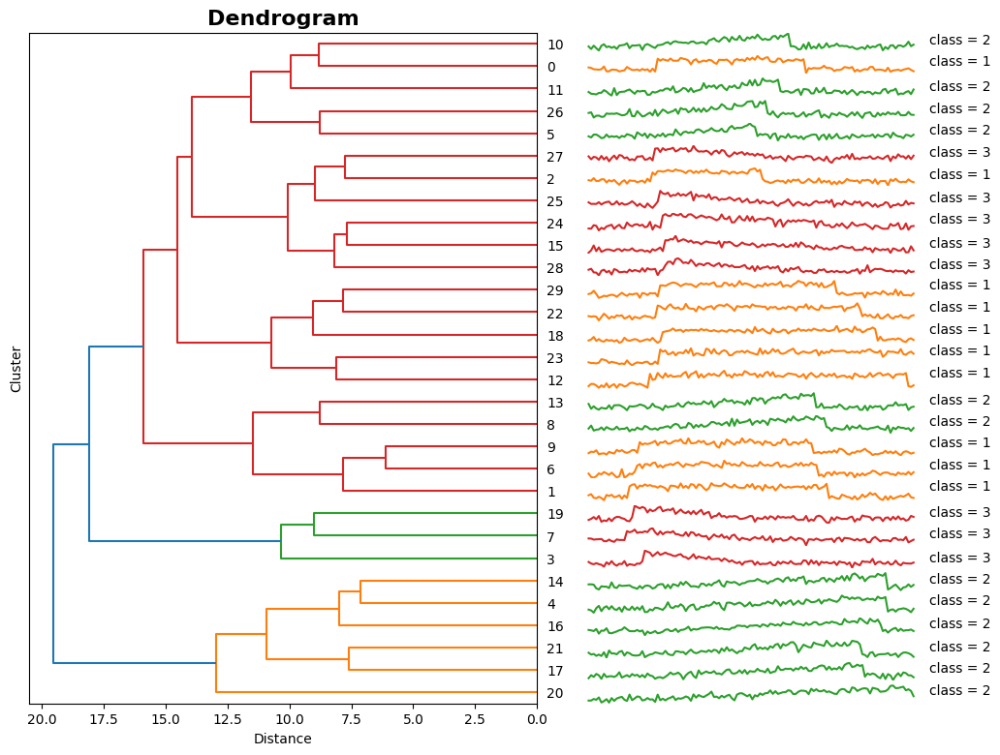

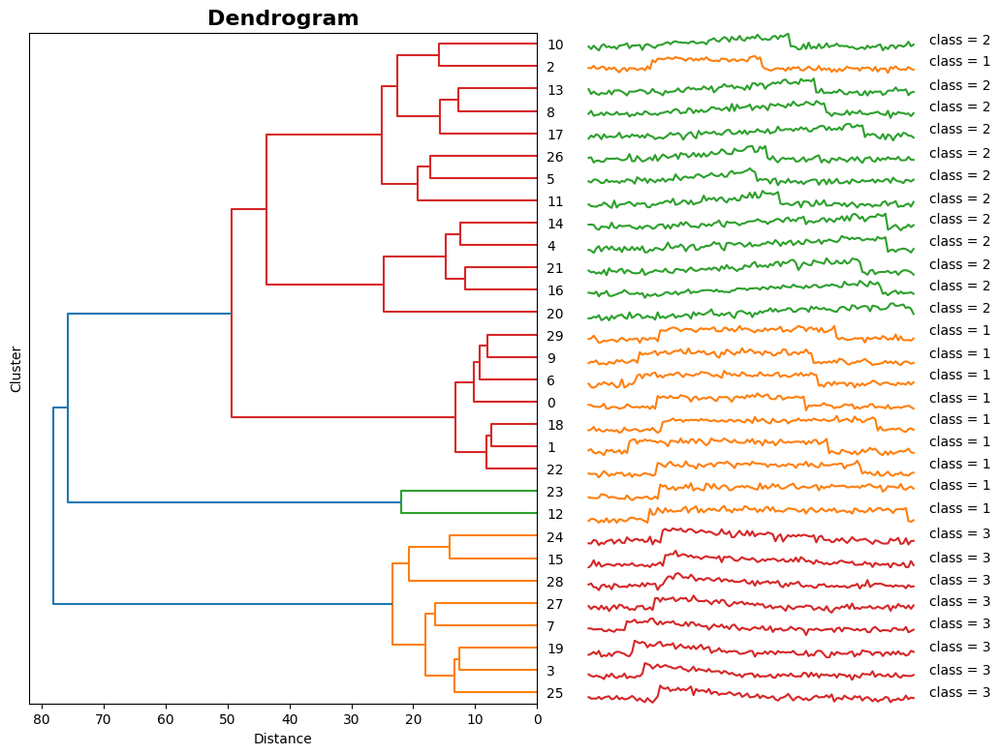

In [15]:
import pandas as pd
from modules.clustering import TimeSeriesHierarchicalClustering

# Инициализация модели кластеризации
clustering_euclidean = TimeSeriesHierarchicalClustering(n_clusters=3, method='complete')
clustering_dtw = TimeSeriesHierarchicalClustering(n_clusters=3, method='complete')

# Кластеризация с использованием евклидовой метрики
clustering_euclidean.fit(distance_matrix_euclidean)
clustering_euclidean.plot_dendrogram(ts_set, labels)

# Кластеризация с использованием DTW меры
clustering_dtw.fit(distance_matrix_dtw)
clustering_dtw.plot_dendrogram(ts_set, labels)

Сравните результаты иерархической кластеризации, полученные при двух различных функций расстояния, с помощью силуэтного коэффициента. Для этого используйте функцию [`silhouette_score()`](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.silhouette_score.html) из библиотеки *sklearn*, передав в нее предвычисленную матрицу расстояний и предсказанные метки.

**Силуэтный коэффициент** – метрика, которая оценивает качество кластеризации на основе исходной выборки и результатов кластеризации без необходимости знания об истинных метках объектов.

Силуэтный коэффициент для выборки показывает, насколько среднее расстояние до объектов своего кластера отличается от среднего расстояния до объектов других кластеров. Пусть дана выборка $X$, состоящая из $N$ объектов. Предположим, что объекты этой выборки были разбиты на кластеры $c_1, ... c_K$, $c_i \in C$, с помощью некоторого алгоритма кластеризации. Тогда силуэтный коэффициент для выборки будет вычисляться следующим образом:

\begin{equation}
sil\_coef = \frac{1}{N} \sum_{c_k \in C} \sum_{x_i \in c_k} \frac{b(x_i, c_k) - a(x_i, c_k)}{\max(a(x_i, c_k), b(x_i, c_k))},
\end{equation}

где $a(x_i, c_k)$ – среднее расстояние от объекта $x_i \in c_k$ до других объектов из этого же кластера $c_k$; <br> $b(x_i, c_k)$  – среднее расстояние от объекта $x_i \in c_k$ до объектов из другого кластера $c_l$, $k \neq l$.

Силуэтный коэффициент принимает значения от  −1  до  1:
*   –1 означает, что кластеры плохие, размытые;
*   0 означает, что кластеры накладываются друг на друга;
*   1 означает, что кластеры плотные и хорошо отделены друг от друга.

Таким образом, чем ближе значение коэффициента к 1, тем лучше кластеризованы данные.

In [16]:
from sklearn.metrics import silhouette_score

# Выполним кластеризацию с евклидовой метрикой
clustering_euclidean = TimeSeriesHierarchicalClustering(n_clusters=3, method='complete')
labels_euclidean = clustering_euclidean.fit_predict(distance_matrix_euclidean)

# Силуэтный коэффициент для евклидовой метрики
silhouette_euclidean = silhouette_score(distance_matrix_euclidean, labels_euclidean, metric="precomputed")
print(f"Силуэтный коэффициент для евклидовой метрики: {silhouette_euclidean}")

# Выполним кластеризацию с DTW метрикой
clustering_dtw = TimeSeriesHierarchicalClustering(n_clusters=3, method='complete')
labels_dtw = clustering_dtw.fit_predict(distance_matrix_dtw)

# Силуэтный коэффициент для DTW метрики
silhouette_dtw = silhouette_score(distance_matrix_dtw, labels_dtw, metric="precomputed")
print(f"Силуэтный коэффициент для DTW метрики: {silhouette_dtw}")


Силуэтный коэффициент для евклидовой метрики: 0.1803917727906887
Силуэтный коэффициент для DTW метрики: 0.3881450644470224


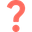
Проанализируйте полученные результаты кластеризации с помощью построенных дендрограмм и вычисленных силуэтных коэффициентов. Какая, на ваш взгляд, функция расстояния показала лучший результат и почему? Укажите, в каких случаях более предпочтительно использовать DTW меру, чем евклидову метрику.

### Анализ кластеризации и силуэтных коэффициентов

1. **Силуэтный коэффициент**:
   - **Евклидовая метрика**: 0.1804
   - **DTW метрика**: 0.3881

   На основании значений силуэтных коэффициентов можно сделать вывод, что кластеризация на основе **DTW метрики** дала лучший результат. Силуэтный коэффициент для DTW метрики выше (0.3881), что указывает на лучшее качество кластеризации по сравнению с евклидовой метрикой (0.1804). Значение силуэта ближе к 1 говорит о том, что кластеры, полученные с использованием DTW, более плотные и хорошо разделены друг от друга.

2. **Дендрограммы**:
   - На первой дендрограмме (евклидовая метрика) видно, что объекты одного класса часто разделяются по разным кластерам. Например, временные ряды класса 1 и 2 перемешиваются между собой в нескольких местах.
   - Вторая дендрограмма (DTW метрика) показывает более четкое разделение. Большинство объектов каждого класса группируются в одном кластере, что указывает на более качественное разбиение.

   Визуально видно, что **DTW метрика** лучше справляется с разделением временных рядов, поскольку она учитывает временные сдвиги и искажения, которые могут возникнуть в данных.

### Почему DTW показала лучший результат?
DTW (Dynamic Time Warping) учитывает временные сдвиги и искажения между временными рядами. Это делает её более подходящей для временных рядов, которые могут быть схожи по форме, но иметь временные различия (например, сдвиги во времени или растяжения). В отличие от евклидовой метрики, которая просто измеряет прямое расстояние между соответствующими точками, DTW сопоставляет точки временных рядов, чтобы минимизировать суммарное расстояние, что даёт более точную оценку сходства между временными рядами.

### Когда лучше использовать DTW метрику?
1. **Временные сдвиги**: Если временные ряды содержат схожие закономерности, но они могут быть сдвинуты по времени (например, один ряд является отложенной версией другого), DTW будет предпочтительнее.
2. **Растяжение и сжатие во времени**: Если закономерности в рядах сохраняются, но временная шкала у одного ряда растянута или сжата по сравнению с другим, DTW лучше справится с задачей их сравнения.
3. **Биометрические данные**: В задачах, где временные сдвиги являются частью нормальных вариаций (например, биометрические данные, такие как шаги или пульс), DTW метрика показывает лучшие результаты.

### Когда лучше использовать евклидову метрику?
1. **Отсутствие временных искажений**: Если временные ряды не содержат сдвигов и искажений, и важна амплитуда данных, евклидова метрика может быть предпочтительнее, поскольку она быстрее и проще в вычислении.
2. **Простые задачи кластеризации**: Для временных рядов, которые находятся в одинаковой фазе и не имеют значительных временных изменений, евклидова метрика может дать хорошие результаты и будет более эффективной.

### Заключение:
- **DTW метрика** показала лучший результат для данной задачи кластеризации временных рядов, так как временные ряды могли иметь временные сдвиги или искажения.
- **Евклидова метрика** справляется хуже, так как не учитывает временные сдвиги, что делает её менее подходящей для кластеризации временных рядов в этом конкретном случае.

## **Часть 2.** $Z$-нормализация временных рядов.

### **Задача 5.**
Реализуйте функцию вычисления нормализованного евклидова расстояния между временными рядами `norm_ED_distance()` в модуле *metrics.py* и проверьте правильность своей реализации, сравнив полученные результаты с результатами функции [`ed_distance()`](https://www.sktime.net/en/latest/api_reference/auto_generated/sktime.distances.euclidean_distance.html) из библиотеки *sktime*, в которую необходимо передать <u>нормализованные</u> временные ряды. Для нормализации временных рядов используйте функцию `z-normalize()` из *utils.py*.  Для проверки можно использовать синтетические временные ряды из первой части или заново их сгенерировать.

**Нормализованная евклидова метрика** между двумя временными рядами $T_1$ и $T_2$ длины $n$ вычисляется следующим образом:

\begin{equation}
	\text{ED}_{norm}(T_1, T_2) = \sqrt {\Big|\; 2n\left(1-\dfrac{<T_1, T_2> - \; n \; \cdotp \mu_{T_1} \; \cdotp \mu_{T_2}}{n \; \cdotp \sigma_{T_1} \; \cdotp \sigma_{T_2}}\right)\Big|},
\end{equation}

где $<T_1, T_2>$ – скалярное произведение временных рядов, $\mu_{T_1}$ и $\mu_{T_2}$, $\sigma_{T_1}$ и $\sigma_{T_2}$ – среднее арифметическое и стандартное отклонение временных рядов соответственно.

**Среднее арифметическое** $\mu_T$ и **стандартное отклонение** $\sigma_T$ временного ряда $T$ длины $n$ вычисляются по следующим формулам:

\begin{equation}
	\mu_{T} = \frac{1}{n}\sum\limits_{i=1}^{n} t_{i}, \\[1em]
	\sigma_{T} = \sqrt{\frac{1}{n}\sum\limits_{i=1}^{n} t_i^2-\mu_{T}^2}.
\end{equation}

In [17]:
from sktime.distances import euclidean_distance

# Пример временных рядов
T1 = np.random.randn(100)
T2 = np.random.randn(100)

# Нормализуем временные ряды
T1_normalized = z_normalize(T1)
T2_normalized = z_normalize(T2)

# Вычисление нормализованного евклидова расстояния с помощью нашей функции
dist_my_func = norm_ED_distance(T1, T2)

# Вычисление евклидова расстояния с помощью sktime
dist_sktime = euclidean_distance(T1_normalized, T2_normalized)

# Сравнение результатов
print(f"Результат моей функции: {dist_my_func}")
print(f"Результат sktime функции: {dist_sktime}")


Результат моей функции: 15.349447516191884
Результат sktime функции: 15.349447516191882


### **Задача 6.**
Далее убедимся, что выполнение $z$-нормализации на этапе предобработки данных имеет важное значение и может повысить точность решаемой задачи.

В данном задании вы продолжите решать задачу иерархической кластеризации. В качестве данных будут использоваться два временных ряда из набора данных [BIDMC](https://physionet.org/content/chfdb/1.0.0/). Набор BIDMC состоит из записей ЭКГ-сигналов, снятых с 15 пациентов с сердечной недостаточностью тяжелой степени.  

Загрузите два временных ряда и визуализируйте их с помощью функции `plot_ts()` из модуля *plots.py*.

In [18]:
url1 = './datasets/part2/chf10.csv'
ts1 = read_ts(url1)

url2 = './datasets/part2/chf11.csv'
ts2 = read_ts(url2)

/Users/davidlimcher/Desktop/Python/TimeSeriesCourse/practice/01 Basics/modules/utils.py:22: FutureWarning:

The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead

/Users/davidlimcher/Desktop/Python/TimeSeriesCourse/practice/01 Basics/modules/utils.py:22: FutureWarning:

The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead



In [19]:
ts_set = np.concatenate((ts1, ts2), axis=1).T

In [20]:
plot_ts(ts_set)

Разделите каждый временной ряд на непересекающиеся подпоследовательности с помощью техники скользящего окна. Для этого используйте функцию `sliding_window()` из модуля *utils.py*, передав в нее временной ряд, заданную длину подпоследовательности и величину шага. В нашем случае, величина шага равна длине подпоследовательности.

In [21]:
m = 125
subs_set1 = sliding_window(ts_set[0], m, m-1)
subs_set2 = sliding_window(ts_set[1], m, m-1)

Сформируйте множество всех подпоследовательностей, извлеченных из двух временных рядов, и массив меток подпоследовательностей в соответствии с их принадлежностью к временному ряду.

In [22]:
subs_set = np.concatenate((subs_set1[0:15], subs_set2[0:15]))
labels = np.array([0]*subs_set1[0:15].shape[0] + [1]*subs_set2[0:15].shape[0])

Добавьте в класс `PairwiseDistance` из модуля *pairwise_distance.py* возможность вычисления нормализованной евклидовой метрики между временными рядами. Если матрица расстояний строится для нормализованных временных рядов на основе евклидовой метрики, то должна вызываться функция `norm_ED_distance()`. Для остальных метрик/мер схожести перед нахождением матрицы расстояний временные ряды должны подтвергаться $z$-нормализации с помощью функции `z_normalize()` из модуля *utils.py*.

Далее выполните иерархическую кластеризацию подпоследовательностей двух временных рядов с использованием предварительно построенных матриц расстояний на основе классической и нормализованной евклидовой метрики.

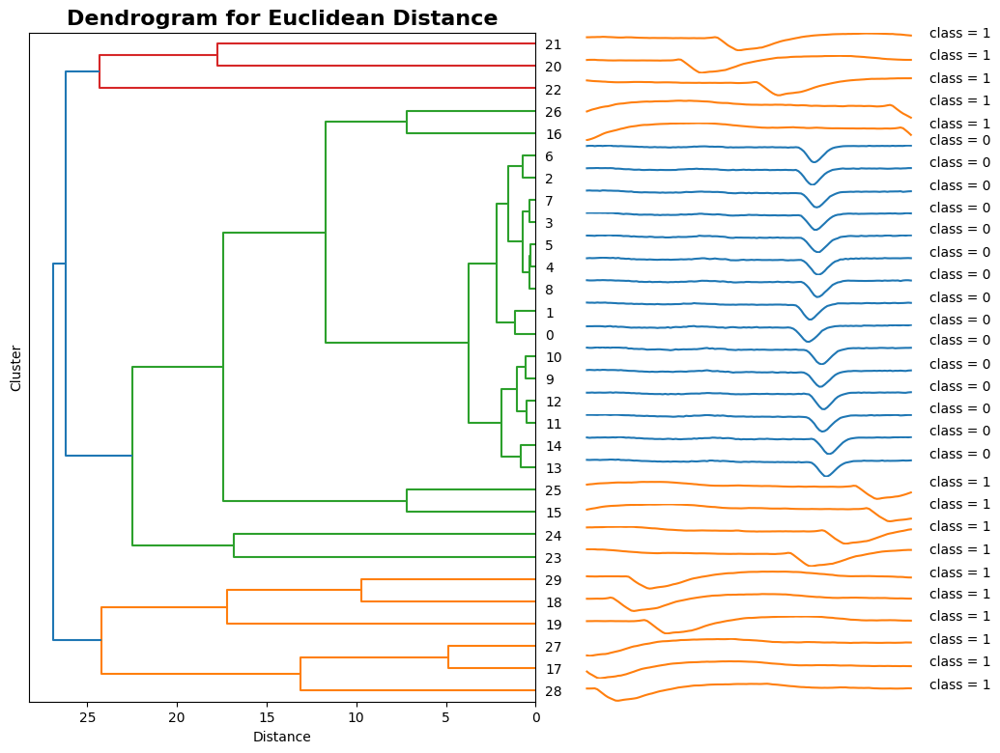

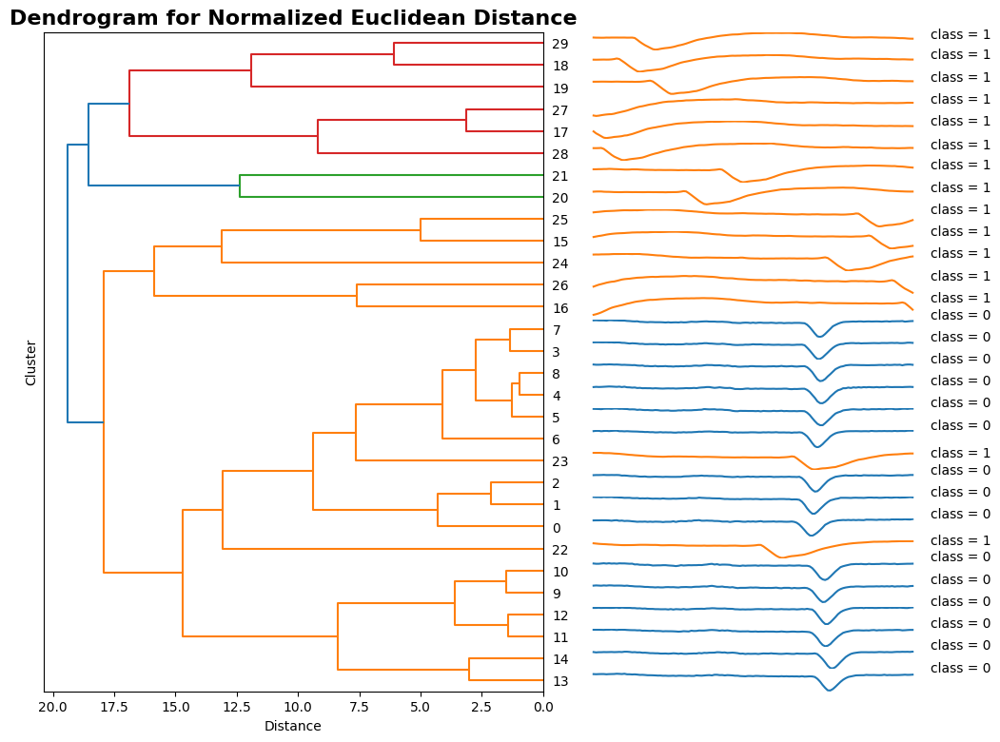

In [23]:
# Вычисляем матрицу расстояний с обычной евклидовой метрикой
pairwise_euclidean = PairwiseDistance(metric='euclidean', is_normalize=False)
distance_matrix_euclidean = pairwise_euclidean.calculate(subs_set)

# Вычисляем матрицу расстояний с нормализованной евклидовой метрикой
pairwise_norm_euclidean = PairwiseDistance(metric='euclidean', is_normalize=True)
distance_matrix_norm_euclidean = pairwise_norm_euclidean.calculate(subs_set)

# Выполняем иерархическую кластеризацию с обычной евклидовой метрикой
clustering_euclidean = TimeSeriesHierarchicalClustering(n_clusters=2, method='complete')
clustering_euclidean.fit(distance_matrix_euclidean)

# Выполняем иерархическую кластеризацию с нормализованной евклидовой метрикой
clustering_norm_euclidean = TimeSeriesHierarchicalClustering(n_clusters=2, method='complete')
clustering_norm_euclidean.fit(distance_matrix_norm_euclidean)

# Преобразуем numpy массив в pandas DataFrame
subs_set_df = pd.DataFrame(subs_set)

# Визуализируем результаты для обычной евклидовой метрики
clustering_euclidean.plot_dendrogram(subs_set_df, labels, title='Dendrogram for Euclidean Distance')

# Визуализируем результаты для нормализованной евклидовой метрики
clustering_norm_euclidean.plot_dendrogram(subs_set_df, labels, title='Dendrogram for Normalized Euclidean Distance')

Вычислите силуэтные коэффициенты для оценки качества кластеризации с нормализацией и без нее, как это было сделано в задаче 4 части 1.

In [24]:
import numpy as np
from sklearn.metrics import silhouette_score

# Вычисляем матрицу расстояний с обычной евклидовой метрикой (без нормализации)
pairwise_euclidean = PairwiseDistance(metric='euclidean', is_normalize=False)
distance_matrix_euclidean = pairwise_euclidean.calculate(subs_set)

# Устанавливаем диагональ матрицы расстояний в 0 для правильной работы silhouette_score
np.fill_diagonal(distance_matrix_euclidean, 0)

# Выполняем кластеризацию с обычной евклидовой метрикой
clustering_euclidean = TimeSeriesHierarchicalClustering(n_clusters=2, method='complete')
labels_euclidean = clustering_euclidean.fit_predict(distance_matrix_euclidean)

# Вычисляем силуэтный коэффициент для обычной евклидовой метрики
silhouette_euclidean = silhouette_score(distance_matrix_euclidean, labels_euclidean, metric="precomputed")
print(f"Силуэтный коэффициент для евклидовой метрики (без нормализации): {silhouette_euclidean}")

# Вычисляем матрицу расстояний с нормализованной евклидовой метрикой (с нормализацией)
pairwise_norm_euclidean = PairwiseDistance(metric='euclidean', is_normalize=True)
distance_matrix_norm_euclidean = pairwise_norm_euclidean.calculate(subs_set)

# Устанавливаем диагональ матрицы расстояний в 0 для правильной работы silhouette_score
np.fill_diagonal(distance_matrix_norm_euclidean, 0)

# Выполняем кластеризацию с нормализованной евклидовой метрикой
clustering_norm_euclidean = TimeSeriesHierarchicalClustering(n_clusters=2, method='complete')
labels_norm_euclidean = clustering_norm_euclidean.fit_predict(distance_matrix_norm_euclidean)

# Вычисляем силуэтный коэффициент для нормализованной евклидовой метрики
silhouette_norm_euclidean = silhouette_score(distance_matrix_norm_euclidean, labels_norm_euclidean, metric="precomputed")
print(f"Силуэтный коэффициент для нормализованной евклидовой метрики: {silhouette_norm_euclidean}")


Силуэтный коэффициент для евклидовой метрики (без нормализации): 0.41829092209953717
Силуэтный коэффициент для нормализованной евклидовой метрики: 0.32752186865268157


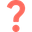
Сравните полученные результаты кластеризации с помощью построенных дендрограмм и вычисленных силуэтных коэффициентов. Позволила ли $z$-нормализации временных рядов повысить качество кластеризации?

### Анализ результатов кластеризации и силуэтных коэффициентов

На основе предоставленных дендрограмм и силуэтных коэффициентов, можно провести следующий анализ:

1. **Силуэтный коэффициент для евклидовой метрики (без нормализации)**: 0.4183
2. **Силуэтный коэффициент для нормализованной евклидовой метрики**: 0.3275

### Дендрограммы:
- На первой дендрограмме (для обычной евклидовой метрики без нормализации) можно видеть, что временные ряды достаточно четко разделены на кластеры. Это подтверждается более высоким силуэтным коэффициентом.
- На второй дендрограмме (для нормализованной евклидовой метрики) можно наблюдать менее четкое разделение, что также подтверждается более низким силуэтным коэффициентом.

### Выводы:

- **Евклидова метрика без нормализации** показала лучший результат в данном случае. Более высокий силуэтный коэффициент (0.4183) указывает на лучшее разделение кластеров.
  
- **Нормализованная евклидова метрика** показала более низкий силуэтный коэффициент (0.3275), что может указывать на то, что нормализация в данном случае не улучшила качество кластеризации. Возможно, данные имеют уже схожий масштаб, и нормализация не нужна.

### Когда лучше использовать нормализованную метрику?
Нормализация обычно улучшает результаты в тех случаях, когда временные ряды имеют разные масштабы или средние значения, что может повлиять на качество кластеризации. Однако, если временные ряды уже находятся в одном масштабе или имеют схожие характеристики, нормализация может даже ухудшить результаты, как это произошло в данном случае.

Таким образом, в вашем случае, где данные изначально могут быть схожими по масштабу, обычная евклидова метрика работает лучше.

## **Часть 3.** Классификация изображений, представленных в виде временных рядов.

### **Задача 7.**
В данном задании вам предстоит выполнить преобразование изображения, на котором находится некоторый объект, во временной ряд. Для этого вы реализуете один из существующих методов, предложенный в [статье Кеога и др](https://dl.acm.org/doi/10.5555/1182635.1164203).

Данный метод заключается в том, что сначала на изображении выполняется поиск контура $E = \{e_i\}_{i=1}^L$, где $e_i$ – точки контура, и центра масс объекта $O$. Затем берутся точки, расположенные на контуре объекта, следующим образом.

Рассмотрим луч $OP$ с началом в центре масс объекта $O$, направление которого совпадает с положительным направлением оси Ox (см. рисунок). Далее выполняется поворот против часовой стрелки луча $OP$ вокруг центра масс $O$ на некоторый заданный угол $α$, $1° \leqslant α \leqslant 360°$. Поворот луча будет осуществляться до тех пор, пока луч не пройдет полный оборот. Все точки $P = \{P_i\}_{i=1}^K$, $P_i \in E$, $K = \lfloor \frac{360°}{α} \rfloor$, образованные пересечением луча $OP$ с контуром $E$ во время поворота, будут являться искомыми.

На завершающем шаге метода вычисляются расстояния между центром масс объекта $O$ и найденными точками на контуре $P$. В качестве функции расстояния может быть использовано манхэттенское или евклидово расстояние. Полученные расстояния будут формировать временной ряд $T$ длины $K$:
\begin{equation}
T = \{t_i\}_{i=1}^K,\;где \; t_i = dist(O, P_i), \; P_i \in P.
\end{equation}

\
<center><img src="https://github.com/mzym/TimeSeriesCourse/blob/main/practice/01%20Basics/img/image2ts.png?raw=true" width="1000"></center>

Поскольку часть 3 предполагает работу с изображениями, то вы будете использовать для реализации некоторых частей кода библиотеку компьютерного зрения *cv2*. Для поиска всех необходимых функций рекомендуем воспользоваться [документацией библиотеки cv2](https://docs.opencv.org/4.x/d6/d00/tutorial_py_root.html).

Загрузите изображение *example.tif* из директории *./datasets/part3* и выполните его визуализацию с помощью соответствующих функций из библиотеки *cv2*.

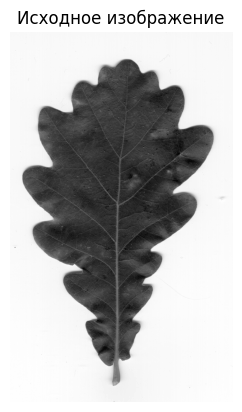

In [25]:
import cv2
import matplotlib.pyplot as plt

# Загрузка изображения
image_path = '/Users/davidlimcher/Desktop/Python/TimeSeriesCourse/practice/01 Basics/datasets/part3/example.tif'  # Путь к загруженному изображению
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Визуализация изображения
plt.imshow(image, cmap='gray')
plt.title('Исходное изображение')
plt.axis('off')
plt.show()

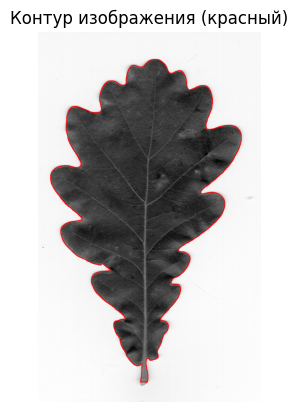

In [26]:

# Применение размытия для сглаживания изображения
blurred_image = cv2.GaussianBlur(image, (5, 5), 0)

# Применение порогового преобразования для выделения объекта
_, threshold = cv2.threshold(blurred_image, 127, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Поиск контуров
contours, _ = cv2.findContours(threshold, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Находим самый большой контур по площади
largest_contour = max(contours, key=cv2.contourArea)

# Преобразование изображения в цветное (BGR) для отображения цветного контура
image_color = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)

# Отобразим только самый большой контур на изображении с красным цветом (в BGR это (0, 0, 255))
contour_img = cv2.drawContours(image_color.copy(), [largest_contour], -1, (0, 0, 255), 2)

# Визуализация изображения с контуром
plt.imshow(cv2.cvtColor(contour_img, cv2.COLOR_BGR2RGB))
plt.title('Контур изображения (красный)')
plt.axis('off')
plt.show()


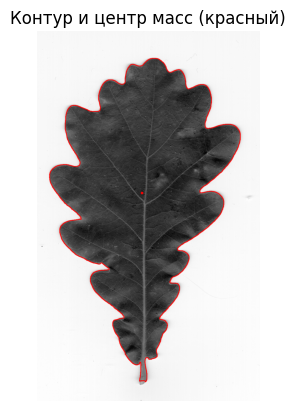

Координаты центра масс: (408, 631)


In [27]:


# Вычисление центра масс объекта для самого большого контура
M = cv2.moments(largest_contour)
if M["m00"] != 0:  # Проверяем, что площадь не равна 0
    cX = int(M["m10"] / M["m00"])
    cY = int(M["m01"] / M["m00"])
else:
    cX, cY = 0, 0  # Если площадь равна 0, центр не определен

# Отображаем центр масс и контур на изображении

# Преобразование изображения в цветной формат (BGR)
image_color = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)

# Отображение центра масс на изображении красным цветом (в BGR это (0, 0, 255))
cv2.circle(image_color, (cX, cY), 5, (0, 0, 255), -1)

# Отображение самого большого контура зеленым цветом (в BGR это (0, 255, 0))
cv2.drawContours(image_color, [largest_contour], -1, (0, 0, 255), 2)

# Визуализация изображения с центром масс и контуром
plt.imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
plt.title('Контур и центр масс (красный)')
plt.axis('off')
plt.show()

# Выводим координаты центра масс
print(f'Координаты центра масс: ({cX}, {cY})')

За конвертацию изображения во временной ряд с помощью описанного выше метода отвечает функция `image2ts()` из модуля *image_converter.py*. Прежде чем исходное изображение будет преобразовано во временной ряд, сначала оно должно пройти этап предварительной обработки. Предварительная обработка включает в себя следующие шаги:

<center><img src="https://github.com/mzym/TimeSeriesCourse/blob/main/practice/01%20Basics/img/image_preprocessing.png?raw=true" width="1000"></center>

Предобработка изображения в `image2ts()` осуществляется с помощью функции `_img_preprocess()`. Реализуйте в данной функции все представленные на диаграмме шаги предварительной обработки средствами библиотеки *cv2*. Промежуточные результаты должны совпадать с представленными на диаграмме.

Далее выполните конвертацию изображения во временной ряд, передав в функцию `image2ts()` следующие заданные вами аргументы:
*   исходное загруженное изображение;
*   шаг угла поворота;
*   параметр, определяющий нужно или нет визуализировать изображение с выделенными на нем контуром, центром масс и лучами, проведенными из центра.

Визуализируйте полученный временной ряд.


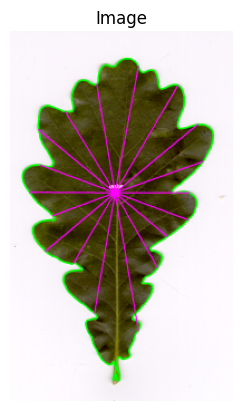

In [28]:
# Параметры для функции image2ts
angle_step = 20
visualize = True

# Загрузка изображения
image_path = '/Users/davidlimcher/Desktop/Python/TimeSeriesCourse/practice/01 Basics/datasets/part3/example.tif'
image = cv2.imread(image_path)

# Создание объекта класса Image2TimeSeries с заданным шагом угла
converter = Image2TimeSeries(angle_step)

# Конвертация изображения во временной ряд
ts = converter.convert(image, visualize)

# Визуализация временного ряда
plot_ts(np.array([ts]), "Time series representation of image")


### **Задача 8.**

Выполните классификацию изображений, представленных в виде временных рядов, с помощью метода $k$ ближайших соседей (kNN).

**Метод $k$ ближайших соседей (kNN)** – алгоритм классификации, заключающийся в вычислении сходства между объектами на основе некоторой заданной метрики/меры схожести. Классифицируемый объект относится к тому классу, к которому принадлежит большинство из его $k$ соседей ($k$ ближайших к нему объектов из обучающей выборки).

Для классификации на основе алгоритма kNN необходимо выполнить следующие шаги:

1. Загрузить обучающую и тестовую выборки.

2. Задать параметр алгоритма $k$, где $k$ – количество ближайших соседей, $k \in \mathbb N^*$.

3. Для каждого объекта из тестовой выборки выполнить следующее:

    3.1. Вычислить расстояние до всех объектов из обучающей выборки на основе заданной метрики/меры схожести.
    
    3.2. Отсортировать в порядке возрастания найденные расстояния.

    3.3. Найти $k$ ближайших соседей, взяв первые $k$ минимальные расстояния из отсортированного массива расстояний.

    3.4. Назначить объекту из тестовой выборки наиболее часто встречающийся класс найденных ранее ближайших соседей.


Для этого задания вам предлагается набор данных, который содержит изображения листьев четырех различных пород деревьев: дуб, ольха, ива и липа. Набор данных состоит из обучающей и тестовой выборок, включающих по 15 и 10 изображений листьев на класс соответственно. Для составления этого набора данных изображения были взяты из [Swedish Leaf Dataset](https://www.cvl.isy.liu.se/en/research/datasets/swedish-leaf/).

Загрузите изображения из обучающей и тестовой выборок, а также их метки, используя `read_images()` и `read_ts()` соответственно.
Выполните визуализацию прецедентов выборки с помощью функции `plot_images()`.


In [29]:

def read_images(dir: str) -> list[np.ndarray]:
    """
    Load all images from a directory

    Parameters
    ----------
    dir: directory path

    Returns
    -------
    images: images from a directory
    """
    images = []
    for img_path in sorted(glob.glob(dir)):
        cv_img = cv2.imread(img_path)
        images.append(cv_img)
    return images

In [30]:
def plot_images(images: list[np.ndarray], labels: np.ndarray, class_names: list[str]) -> None:
    """
    Plot some images from dataset

    Parameters
    ----------
    images: dataset of images
    labels: labels of images
    class_names: class names of images
    """
    rows = 2
    columns = 4

    fig, axes = plt.subplots(nrows=rows, ncols=columns, figsize=(columns*2, rows*3))

    for num in range(1, rows*columns+1):
        fig.add_subplot(rows, columns, num)
        idx = num - 1
        plt.imshow(images[idx], aspect='auto')
        plt.title(f'{class_names[labels[idx]]}', fontsize=10)

    fig.tight_layout()

    for idx, ax in enumerate(axes.flat):
        ax.set_xticks([])
        ax.set_yticks([])

In [31]:
# Загрузка данных
train_set_path = "./datasets/part3/train_set_leaves/*.tif"
test_set_path = "./datasets/part3/test_set_leaves/*.tif"

train_images = read_images(train_set_path)
test_images = read_images(test_set_path)

train_label_path = './datasets/part3/train_set_leaves/train_label.csv'
test_label_path = './datasets/part3/test_set_leaves/test_label.csv'

train_labels = np.loadtxt(train_label_path, delimiter=',', dtype=int)
test_labels = np.loadtxt(test_label_path, delimiter=',', dtype=int)

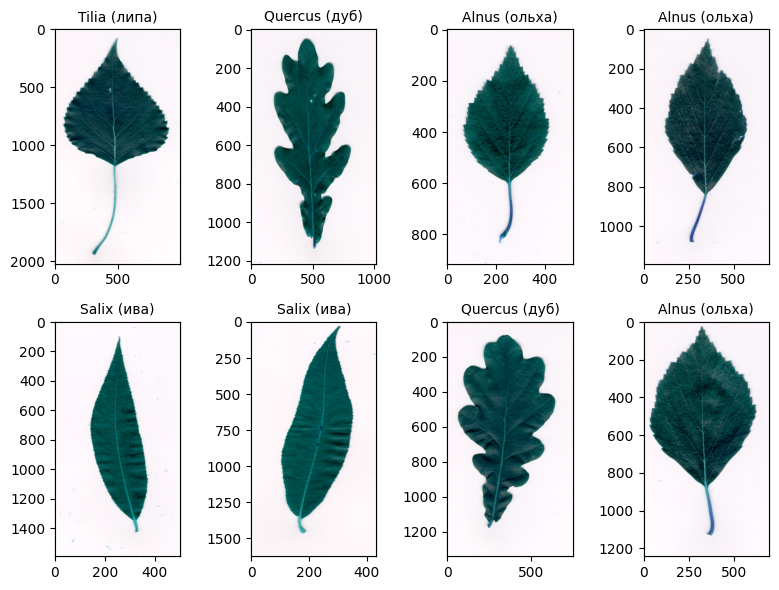

In [32]:
class_names = ['Quercus (дуб)', 'Alnus (ольха)', 'Salix (ива)', 'Tilia (липа)']
plot_images(train_images, train_labels, class_names)

Выполните преобразование изображений обучающей и тестовой выборок во временные ряды с помощью функции `image2ts()`.  

In [33]:
# Параметры для функции image2ts
angle_step = 20
visualize = False  # Для классификации не требуется визуализация

# Функция для преобразования всех изображений в выборке во временные ряды
def images_to_ts(images, angle_step=20, visualize=False):
    ts_list = []
    converter = Image2TimeSeries(angle_step=angle_step)  # Используем шаг угла
    for img in images:
        ts = converter.convert(img, is_visualize=visualize)
        ts_list.append(ts)
    return np.array(ts_list)

# Преобразование изображений обучающей и тестовой выборок во временные ряды
train_ts = images_to_ts(train_images, angle_step=angle_step, visualize=visualize)
test_ts = images_to_ts(test_images, angle_step=angle_step, visualize=visualize)

print("Размеры временных рядов для обучающей выборки:", train_ts.shape)
print("Размеры временных рядов для тестовой выборки:", test_ts.shape)

Размеры временных рядов для обучающей выборки: (60, 18)
Размеры временных рядов для тестовой выборки: (40, 18)


Для классификации временных рядов методом $k$ ближайших соседей вам необходимо использовать класс `TimeSeriesKNN` из модуля *classification.py*.
Реализуйте метод `fit()` в классе `TimeSeriesKNN`, который выполняет поиск для каждого элемента из тестовой выборки $k$ ближайших соседей и назначает им тот класс, который является часто встречающимся среди классов ближайших соседей. В качестве параметров в метод `fit()` передается тестовая выборка. Вычислите точность классификации по метрике accuracy с помощью функции `calculate_accurary()` из модуля *classification.py*.

In [34]:
n_neighbors = 6
metric = 'euclidean'
metric_params = {'normalize': True}

# Обучение модели с евклидовой метрикой
knn_euclidean = TimeSeriesKNN(n_neighbors=n_neighbors, metric=metric, metric_params=metric_params)
knn_euclidean.fit(train_ts, train_labels)
y_pred_euclidean = knn_euclidean.predict(test_ts)

# Вычисляем точность
accuracy_euclidean = calculate_accuracy(test_labels, y_pred_euclidean)
print(f'Точность для евклидовой метрики: {accuracy_euclidean}')

Точность для евклидовой метрики: 0.675


In [35]:
metric = 'dtw'
metric_params = {'normalize': True}


knn_dtw = TimeSeriesKNN(n_neighbors=n_neighbors, metric=metric, metric_params=metric_params)
knn_dtw.fit(train_ts, train_labels)
y_pred_dtw = knn_dtw.predict(test_ts)

# Вычисляем точность
accuracy_dtw = calculate_accuracy(test_labels, y_pred_dtw)
print(f'Точность для DTW метрики: {accuracy_dtw}')

Точность для DTW метрики: 0.65


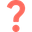
Проанализируйте результаты и сделайте выводы.

На основании представленных результатов:

1. **Точность для евклидовой метрики** составила 67.5%. Это означает, что использование нормализованного евклидового расстояния привело к корректной классификации около двух третей тестовых изображений. Евклидова метрика хорошо работает, когда временные ряды имеют схожие масштаб и форму, что может говорить о том, что образы листьев имеют определенные характерные геометрические признаки.

2. **Точность для метрики DTW (динамического временного искривления)** составила 65%. Этот результат чуть ниже, чем при использовании евклидовой метрики. DTW обычно более полезен, когда временные ряды могут быть искажены во времени (например, если форма листа изменяется в зависимости от угла поворота или растяжения), но для данного набора данных и конкретных временных рядов DTW оказалась менее эффективной.

### Выводы:
- Евклидова метрика оказалась чуть более эффективной для данной задачи классификации изображений листьев, представленных в виде временных рядов, чем DTW. Это может быть связано с тем, что структура листьев на изображениях довольно схожа, и временные ряды достаточно хорошо представлены в виде фиксированных пространственных признаков (например, ширина и форма листа).
  
- DTW, несмотря на то, что она полезна для задач, связанных с временными искажениями, возможно, не принесла дополнительных преимуществ в данной задаче из-за того, что форма листьев на изображениях не сильно изменяется по времени.

- Для улучшения точности можно попробовать поэкспериментировать с параметрами DTW или с другими метриками расстояния, а также с увеличением объема данных.